# Setup

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import sqlalchemy as sa

# Load data

In [2]:
con = sa.create_engine('sqlite:///DatosCaso1/airbnb.db')
df = pd.read_sql_table('df_ready', con)
df.head()

,level_0,index,id,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,...,precio_m2,distrito,total_price,occupancy,bedrooms_disc,accommodates_disc,beds_disc,number_of_reviews_disc,m2,pdi_sol
0,0,0,21853,Bright and airy room,83531,Latina,Cármenes,40.40381,-3.74130,Private room,...,3116,Latina,31.0,60,01_One,0-3,1,5-48,50,3.521406
1,1,1,62423,MAGIC ARTISTIC HOUSE IN THE CENTER OF MADRID,303845,Centro,Justicia,40.41884,-3.69655,Private room,...,6739,Centro,96.6,9,01_One,4,1,48-744,50,0.621024
2,2,2,70073,Adorable Apartment Malasaña-Gran Via,353738,Centro,Universidad,40.42252,-3.70250,Entire home/apt,...,6739,Centro,80.0,25,01_One,0-3,1,5-48,50,0.648148
3,3,3,70310,"Heart of Malasaña Cozy, Quiet & Sunny Apartment",353738,Centro,Universidad,40.42252,-3.70250,Entire home/apt,...,6739,Centro,64.0,18,01_One,0-3,1,5-48,50,0.648148
4,4,4,72150,Sunny attic duplex flat with terrace next to Sol,364585,Centro,Embajadores,40.41150,-3.70449,Entire home/apt,...,6739,Centro,159.0,50,03_Three,5-16,3-24,48-744,90,0.589586


# Analysis

## Price

**What is the average price? What is the price range? What about by district? What about by neighborhood?**

**What is the ranking of districts and neighborhoods by average rental price?**

In [5]:
df.total_price.describe()

count    20634.000000
mean       145.060206
std        491.263591
min         20.000000
25%         66.000000
50%         98.700000
75%        141.300000
max      21347.000000
Name: total_price, dtype: float64

In [6]:
df.total_price.median()

98.69999999999999

In [7]:
df.groupby('distrito').total_price.median().sort_values(ascending = False)

distrito
Salamanca                124.0
Centro                   112.0
Chamberí                 108.0
Chamartín                107.0
Moncloa - Aravaca        100.0
Retiro                   100.0
Tetuán                    92.0
Arganzuela                87.5
Hortaleza                 86.0
Fuencarral - El Pardo     80.5
San Blas - Canillejas     77.0
Ciudad Lineal             75.5
Barajas                   70.5
Latina                    64.4
Carabanchel               64.2
Puente de Vallecas        63.0
Villaverde                61.0
Usera                     59.0
Villa de Vallecas         58.9
Vicálvaro                 55.0
Moratalaz                 50.9
Name: total_price, dtype: float64

In [9]:
df.columns

Index(['level_0', 'index', 'id', 'name', 'host_id', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'calculated_host_listings_count', 'availability_365',
       'description', 'host_is_superhost', 'accommodates', 'bedrooms', 'beds',
       'number_of_reviews', 'review_scores_rating',
       'review_scores_communication', 'review_scores_location', 'precio_m2',
       'distrito', 'total_price', 'occupancy', 'bedrooms_disc',
       'accommodates_disc', 'beds_disc', 'number_of_reviews_disc', 'm2',
       'pdi_sol'],
      dtype='object')

In [10]:
temp = df.groupby('distrito')[['total_price','price']].median()
temp

,total_price,price
distrito,,
Arganzuela,87.5,183645.0
Barajas,70.5,133595.0
Carabanchel,64.2,101640.0
Centro,112.0,235865.0
Chamartín,107.0,232470.0
Chamberí,108.0,258790.0
Ciudad Lineal,75.5,140035.0
Fuencarral - El Pardo,80.5,152285.0
Hortaleza,86.0,159740.0


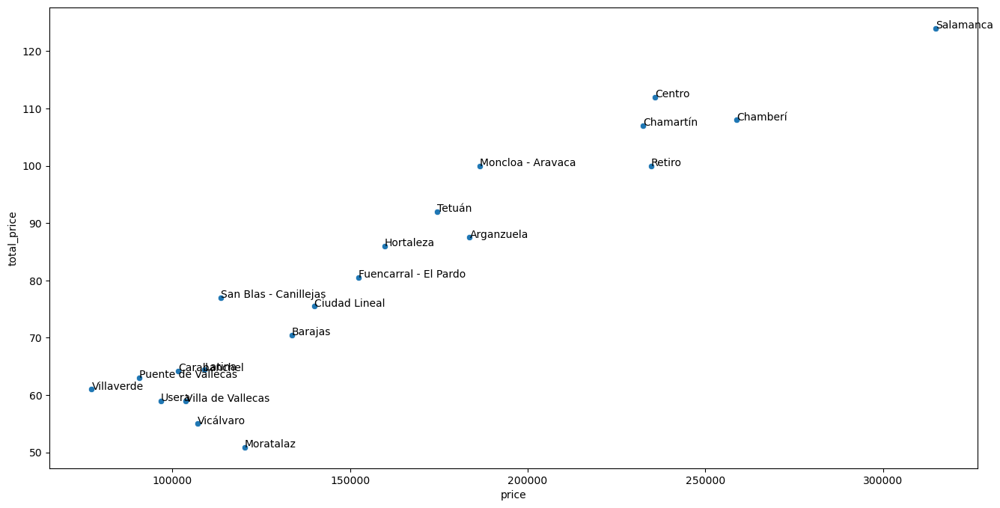

In [15]:
plt.figure(figsize = (16,8))
sns.scatterplot(data = temp, x = 'price', y = 'total_price')

for each in range(0,temp.shape[0]):
    plt.text(temp.price.iloc[each], temp.total_price.iloc[each], temp.index[each])

There is a clear correlation between the purchase price in each district and the price we can charge.

Three clusters are clearly discernible: low-low, medium-medium, and high-high.

Therefore, as expected, there are no clear “bargains” at this level. Let's repeat the analysis at the neighborhood level to see if we can identify anything.

In [16]:
temp = df.groupby('neighbourhood')[['total_price','price']].median()
temp

,total_price,price
neighbourhood,,
Abrantes,47.0,101640.0
Acacias,80.0,183645.0
Adelfas,88.0,234780.0
Aeropuerto,54.0,133595.0
Aguilas,50.0,109060.0
...,...,...
Valverde,75.0,152285.0
Ventas,65.0,140035.0
Vinateros,33.0,120365.0


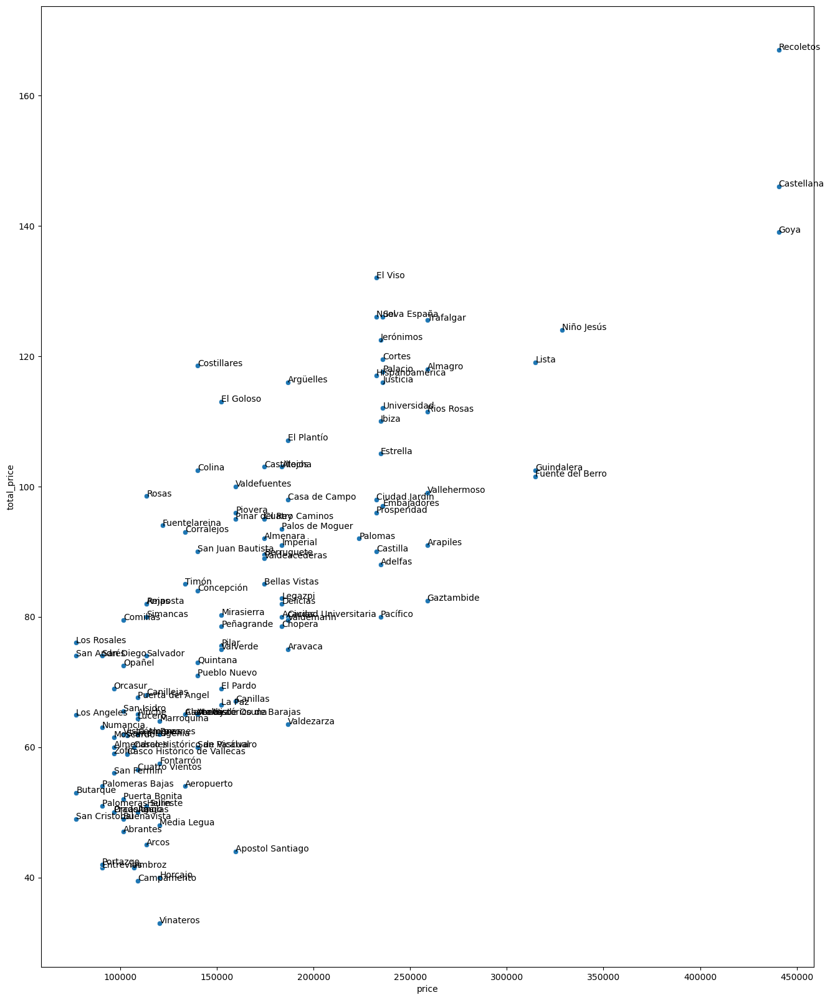

In [17]:
plt.figure(figsize = (16,20))
sns.scatterplot(data = temp, x = 'price', y = 'total_price')

for each in range(0,temp.shape[0]):
    plt.text(temp.price.iloc[each], temp.total_price.iloc[each], temp.index[each])

At this level, we can see more things:

* Within each low-medium-high group, we can begin to separate them
* Low: Simancas, Ambroz, Marroquina, San Juan Bautista
    * Medium: El Plantio, Valdemarín, Valdefuentes
* Medium-high: Jerónimos, Fuentela Reina
* High: Recoletos

**Insight: There are certain neighborhoods that, a priori, can maximize the cost-income ratio, and we can also segment them by the type of property quality in which we are interested in investing**

**What factors (apart from location) determine the rental price?**

In [18]:
metrics = ['total_price','price']
dimensions = ['bedrooms_disc','accommodates_disc','beds_disc','number_of_reviews_disc']

minicube_price = df[dimensions + metrics]
minicube_price

,bedrooms_disc,accommodates_disc,beds_disc,number_of_reviews_disc,total_price,price
0,01_One,0-3,1,5-48,31.0,109060.0
1,01_One,4,1,48-744,96.6,235865.0
2,01_One,0-3,1,5-48,80.0,235865.0
3,01_One,0-3,1,5-48,64.0,235865.0
4,03_Three,5-16,3-24,48-744,159.0,424557.0
...,...,...,...,...,...,...
20629,01_One,4,1,1-4,258.0,109060.0
20630,01_One,0-3,1,1-4,20.0,235865.0
20631,01_One,0-3,1,1-4,69.0,90685.0
20632,01_One,0-3,1,1-4,258.0,109060.0


In [21]:
minicube_price = minicube_price.melt(id_vars=['total_price','price'])
minicube_price

,total_price,price,variable,value
0,31.0,109060.0,bedrooms_disc,01_One
1,96.6,235865.0,bedrooms_disc,01_One
2,80.0,235865.0,bedrooms_disc,01_One
3,64.0,235865.0,bedrooms_disc,01_One
4,159.0,424557.0,bedrooms_disc,03_Three
...,...,...,...,...
82531,258.0,109060.0,number_of_reviews_disc,1-4
82532,20.0,235865.0,number_of_reviews_disc,1-4
82533,69.0,90685.0,number_of_reviews_disc,1-4
82534,258.0,109060.0,number_of_reviews_disc,1-4


In [22]:
minicube_price = minicube_price.groupby(['variable','value'])[['total_price','price']].agg('median')
minicube_price

total_price     price
variable               value                                 
accommodates_disc      0-3                     76.0  234780.0
                       4                      115.0  235865.0
                       5-16                   168.0  330211.0
bedrooms_disc          00_Zero                 87.0  188692.0
                       01_One                  82.0  235865.0
                       02_Two                 134.0  330211.0
                       03_Three               180.0  424557.0
                       04_Four or more        266.0  566076.0
beds_disc              1                       86.0  235865.0
                       2                      139.0  330211.0
                       3-24                   183.0  330211.0
number_of_reviews_disc 1-4                     99.4  235865.0
                       48-744                  98.0  235865.0
                       5-48                    98.0  235865.0

We analyze each variable on the mini cube.

In [23]:
minicube_price.loc['bedrooms_disc']

,total_price,price
value,,
00_Zero,87.0,188692.0
01_One,82.0,235865.0
02_Two,134.0,330211.0
03_Three,180.0,424557.0
04_Four or more,266.0,566076.0


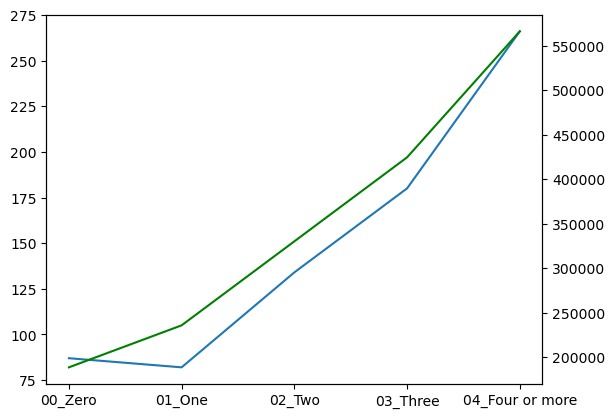

In [24]:
f, ax = plt.subplots()
ax.plot(minicube_price.loc['bedrooms_disc'].total_price)
ax2 = ax.twinx()
ax2.plot(minicube_price.loc['bedrooms_disc'].price,color = 'green');

In [25]:
minicube_price.loc['beds_disc']

,total_price,price
value,,
1,86.0,235865.0
2,139.0,330211.0
3-24,183.0,330211.0


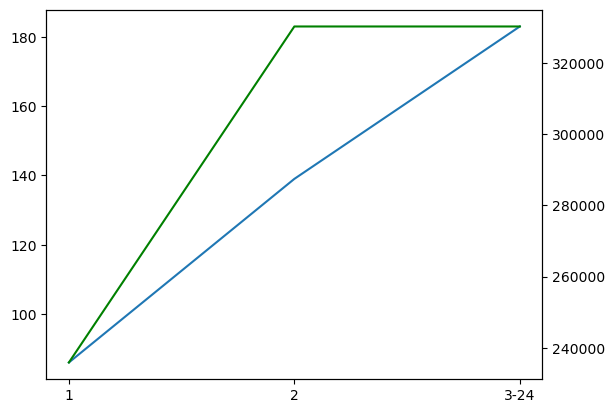

In [26]:
f, ax = plt.subplots()
ax.plot(minicube_price.loc['beds_disc'].total_price)
ax2 = ax.twinx()
ax2.plot(minicube_price.loc['beds_disc'].price,color = 'green');

**Insight: the number of beds to avoid is 2. Either we put in one bed or we try to fit in as many as possible.**

Given that this effect was not seen in the number of rooms, could it be that owners are trying to fit in many more beds than rooms to maximize income?

Let's look at this using one-bedroom apartments as an example:

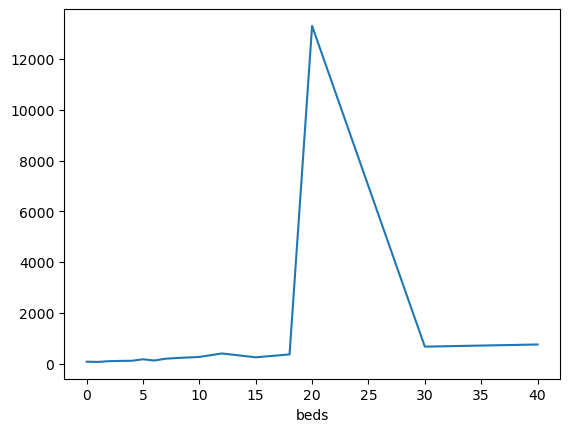

In [27]:
df[df.bedrooms == 1].groupby('beds').total_price.median().plot();

In [28]:
df.loc[(df.bedrooms == 1)& (df.beds > 8)]

,level_0,index,id,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,...,precio_m2,distrito,total_price,occupancy,bedrooms_disc,accommodates_disc,beds_disc,number_of_reviews_disc,m2,pdi_sol
4424,4424,4424,40871059,8 Bed Mixed Dorm Shared Bathroom,314662107,Centro,Embajadores,40.411090,-3.702660,Shared room,...,6739,Centro,756.0,2,01_One,0-3,3-24,5-48,50,0.629700
5024,5024,5024,46416127,"Madrid Center: Puerta del Sol, Tirso de Molina",38098725,Centro,Embajadores,40.411260,-3.704090,Shared room,...,6739,Centro,189.0,5,01_One,0-3,3-24,48-744,50,0.611482
6845,6845,6845,590309986337177910,Art Seven Hostel - Cápsula Individual,451189684,Centro,Embajadores,40.413480,-3.703170,Shared room,...,6739,Centro,672.0,0,01_One,0-3,3-24,48-744,50,0.361523
6949,6949,6949,600789912630118943,Cama en habitación compartida x 10 (mixta),453229690,Centro,Universidad,40.422500,-3.704960,Shared room,...,6739,Centro,210.0,1,01_One,5-16,3-24,5-48,50,0.656536
7122,7122,7122,609912450623640129,Cama en Habitación compartida 12 personas,453229690,Centro,Universidad,40.422730,-3.703310,Shared room,...,6739,Centro,252.0,1,01_One,5-16,3-24,5-48,50,0.667607
7436,7436,7436,644726267441640007,habitación compartida.12 Personas.,453229690,Centro,Universidad,40.421320,-3.703090,Shared room,...,6739,Centro,252.0,3,01_One,5-16,3-24,5-48,50,0.511208
7771,7771,7771,681807241664662257,CAMA EN HABITACIÓN COMPARTIDA 10PERSONAS,453229690,Centro,Universidad,40.422270,-3.702820,Shared room,...,6739,Centro,210.0,2,01_One,5-16,3-24,5-48,50,0.618001
7775,7775,7775,682390524307350727,CAMA EN HABITACIÓN COMPARTIDA 6 HUESPEDES MUJE...,453229690,Centro,Universidad,40.420970,-3.703530,Shared room,...,6739,Centro,252.0,1,01_One,5-16,3-24,5-48,50,0.472122
7825,7825,7825,678839511440564589,Art Seven Hostel - Cápsula habitación compartida,451189684,Centro,Embajadores,40.413121,-3.704288,Private room,...,6739,Centro,602.0,3,01_One,0-3,3-24,5-48,50,0.409118
9527,9527,9527,831925213610287553,"2 Camas en hab. compartida-baño privado, 5 lit...",493916828,Centro,Universidad,40.421891,-3.703881,Shared room,...,6739,Centro,266.0,27,01_One,0-3,3-24,1-4,50,0.576086


In [29]:
minicube_price.loc['accommodates_disc']

,total_price,price
value,,
0-3,76.0,234780.0
4,115.0,235865.0
5-16,168.0,330211.0


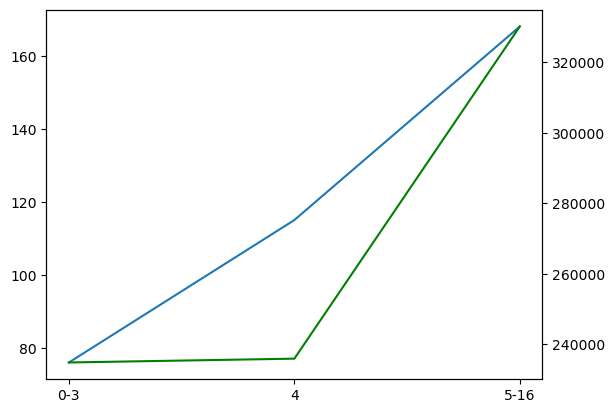

In [30]:
f, ax = plt.subplots()
ax.plot(minicube_price.loc['accommodates_disc'].total_price)
ax2 = ax.twinx()
ax2.plot(minicube_price.loc['accommodates_disc'].price,color = 'green');

**Insight: The optimal number of guests is 3, as the price of properties to accommodate 3 is the same as to accommodate 1 or 2. From 4 guests onwards, the apartment needs to be larger and the purchase price increases significantly.**

Finally, we will analyze the variable we have constructed for proximity to a point of interest to see if it has an effect on room prices.

To do this, we will first calculate the average distance per district and choose a cutoff point.

In [31]:
df.groupby('distrito').pdi_sol.median().sort_values()

distrito
Centro                    0.727110
Arganzuela                1.816653
Chamberí                  2.073742
Moncloa - Aravaca         2.155715
Retiro                    2.426511
Salamanca                 2.805730
Latina                    3.336362
Carabanchel               3.583816
Usera                     3.863118
Puente de Vallecas        4.275521
Chamartín                 4.623148
Tetuán                    4.658765
Moratalaz                 4.909603
Ciudad Lineal             5.139930
Villaverde                7.522390
Fuencarral - El Pardo     7.589192
Hortaleza                 8.140896
San Blas - Canillejas     8.148066
Vicálvaro                 8.511886
Villa de Vallecas         8.789300
Barajas                  11.623357
Name: pdi_sol, dtype: float64

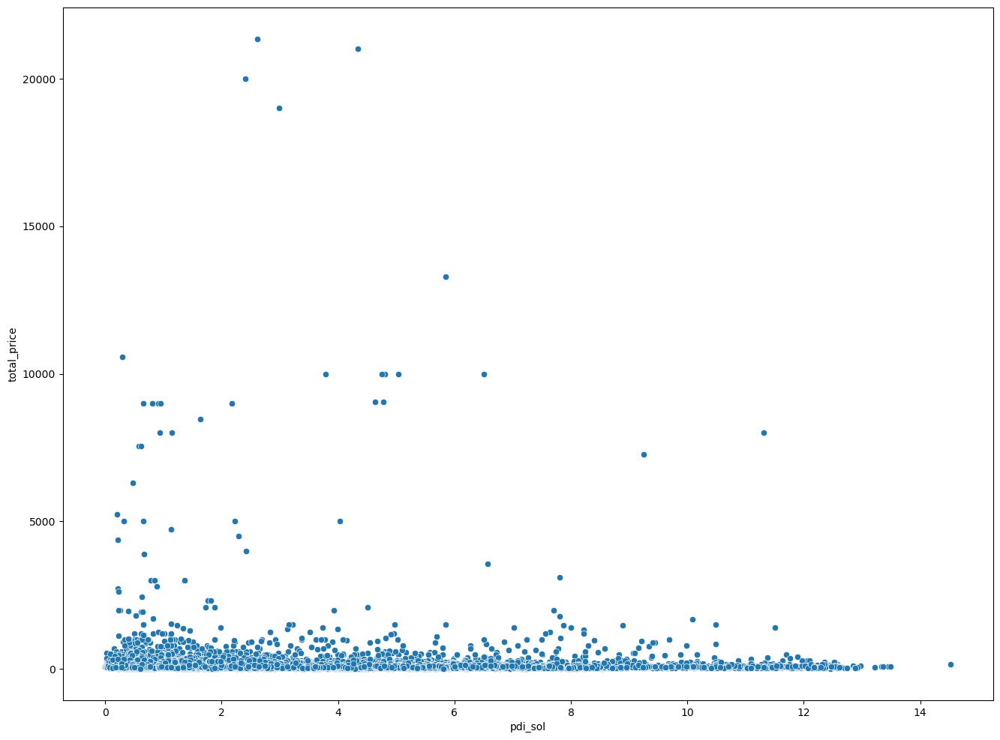

In [33]:
selection = df.groupby('distrito').pdi_sol.median().sort_values().index.to_list()

plt.figure(figsize = (16,12))
sns.scatterplot(data = df.loc[df.distrito.isin(selection)], x = 'pdi_sol', y = 'total_price');

**Insight: Being within the district, it seems that proximity to points of interest does not have as much impact as one might expect. This opens the door to looking for properties that are in a central district but are not right next to the POI and therefore are likely to have a lower purchase price.**

## Geographical analysis

In [34]:
import folium

In [35]:
folium.Map(location=[40.4167278, -3.7033387],zoom_start=12)

In [36]:
map = folium.Map(location=[40.4167278, -3.7033387],zoom_start=12)

for flat in range(0,len(df)):
   folium.Marker(
      location = [df.iloc[flat]['latitude'], df.iloc[flat]['longitude']],
      popup = df.iloc[flat]['total_price'],
   ).add_to(map)

map